In [1]:
%cd ..
%load_ext autoreload
%autoreload 2

from pykitti.tracking import KittiTrackingLabels
from datasets.PyKitti2Dataset import PyKitti2
from hugeica import *
from Mine import *
from hugeica import Adam_Lie
from Crop import crop

import imageio
from PIL import Image

import numpy as np
import matplotlib.pyplot as plt
import torch.nn as nn
import torch

from sklearn.neighbors import NearestNeighbors
from AutoCalibration import *

basedir = "/home/ios/data3/kitti/tracking/training"
seq = "0000"

/home/ios/git_repos/rgbd-registration
Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# Load Data

files 154


/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


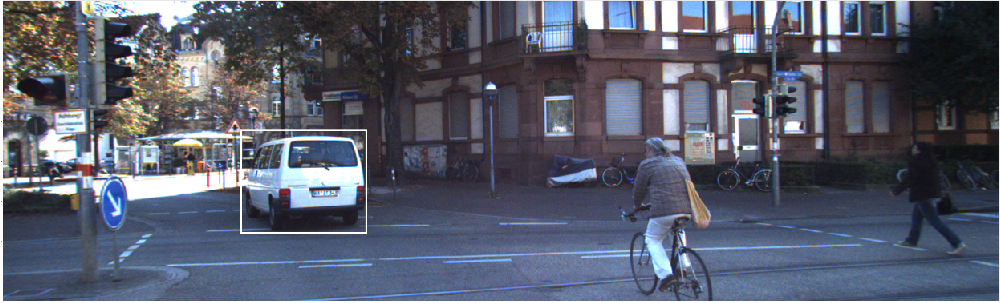

In [4]:
kitti = PyKitti2(basedir, seq, with_labels="box")   

image = kitti[0][1]
box = kitti[0][4][0].astype(int)
label = kitti[0][5][0]
label_num = KittiTrackingLabels.classes.index(label)
image = np.asarray(image).copy()

def box_to_image(image, box, border=2):
    x1,y1, x2, y2 = box
    inside = image[y1:y1+y2, x1:x1+x2, :].copy()
    image[y1:y1+y2, x1:x1+x2, :] = (255, 255, 255)
    image[y1+border:y1+y2-border, x1+border:x1+x2-border, :] = inside[border:-border, border:-border, :]
    plt.rcParams["figure.figsize"] = (200, 100)
    plt.imshow(image)
    plt.show()

def px_in_box(query_px, box):
    x1,y1, x2, y2 = box

    a = np.logical_and(query_px[:, 0] >= x1, 
                        query_px[:, 0] <= (x1 + x2)) 
    b = np.logical_and(query_px[:, 1] >= y1, 
                          query_px[:, 1] <= (y1 + y2))
    return np.logical_and(a, b)    
    
box_to_image(image, box)

In [5]:
datas = [PyKitti2(basedir, f"{i:04d}", with_labels="none") for i in range(10)]

kitti1 = datas[0]
initRT = kitti1.calib.T_cam2_velo.copy()

files 154
files 447
files 233
files 144
files 314
files 297


/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


files 270
files 800
files 390
files 803


In [6]:
# Kitti dataset is recalibrated on different days, so we can just test on sequences that have the same calibration
datas_test1 = [PyKitti2(basedir, f"{i:04d}", with_labels="none") for i in range(10,14)]

files 294
files 373
files 78
files 340


In [7]:
datas_test2 = [PyKitti2(basedir, f"{i:04d}", with_labels="none") for i in range(14,18)]

files 106
files 376
files 209
files 145


In [8]:
datas_test3 = [PyKitti2(basedir, f"{i:04d}", with_labels="none") for i in range(18,20)]

files 339
files 1059


In [9]:
datas_test4 = [PyKitti2(basedir, f"{i:04d}", with_labels="none") for i in range(20,21)]

files 837


In [10]:
datas_test = [datas_test1, datas_test2, datas_test3, datas_test4]

In [11]:
calib0 = datas_test1[0].calib.T_cam2_velo
calib1 = datas_test2[0].calib.T_cam2_velo
calib2 = datas_test3[0].calib.T_cam2_velo
calib3 = datas_test4[0].calib.T_cam2_velo

calib = [calib0, calib1, calib2, calib3]

datas_test

[[PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0010)[294],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0011)[373],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0012)[78],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0013)[340]],
 [PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0014)[106],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0015)[376],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0016)[209],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0017)[145]],
 [PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0018)[314],
  PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0019)[1059]],
 [PyKitti2(base_path=/home/ios/data3/kitti/tracking/training, sequence=0020)[837]]]

# Video

## seq

In [154]:
from datasets.MultiSenseDataset import *


BASE_DIR = "/home/ios/data3_/multisense/"

ds = MultiSenseData(BASE_DIR, rectified=True, crop=[0 ,0, -1, -1])
velo, cam_left, cam_right, _ = ds[450]

cal = np.load("./calib/multisense_seq_27_RT_old_to_new_recentered_GT.npy")

In [155]:
ac = AutoCalibration(cal,                               
                     ds.calib.P_rect_20, 
                     pc_batch=5000,  
                     M=24,       
                     patch_size=96, 
                     hidden_size=32,     
                     max_z=250,
                     clip_floor_3d = -2
                    )
ac.to("cuda")
ac.load_state_dict(torch.load("checkpoints/mi_model_p96_small_registered.pth.tar"))
ac.reset_calibration()

r, t = randomRT(0.01, 2)
ac.distort_calibration(t, [0.40, 1.82, 0.09])

In [156]:
checkpoints = glob.glob("checkpoints/seq/checkpoint_*.pth.tar")
checkpoints = [chkp for chkp in checkpoints if not ("best" in chkp or "last" in chkp)]
idxe = [chkp.split("checkpoints/seq/checkpoint_")[1].split(".pth.tar")[0] for chkp in checkpoints]
idx_sort = np.argsort(np.asarray(idxe).astype(np.int32))
checkpoints = np.array(checkpoints)[idx_sort]

In [157]:
frames = []

iter_ = iter(checkpoints)


old = ac.RT()
chkp = next(iter_)
ac.load_state_dict(torch.load(chkp))
new = ac.RT()

for idx in range(len(ds)):
    
    if (idx+1) % (len(ds) // len(checkpoints)) == 0:
        old = new.copy()
        try:
            chkp = next(iter_)
        except StopIteration:
            break
        ac.load_state_dict(torch.load(chkp))
        new = ac.RT()
        print("frame:", idx, "checkpoint:", chkp)
        
    # linear interpolate
    interval_length = (len(ds) // len(checkpoints))
    t = ((idx + 1) % interval_length)/interval_length
    ac.R.weight.data = torch.from_numpy( t * new[:3, :3] + (1-t) * old[:3, :3] ).to(ac.R.weight.data.device).float()
    ac.T.bias.data = torch.from_numpy( t * new[:3, 3] + (1-t) * old[:3, 3] ).to(ac.T.bias.data.device).float()
    
    #idx = 0
    
    point_cloud, cam2, image3, oxts = ds[idx]
    image, x, y, z, mask, max_x, max_y, max_z, valid_proj_pointcloud = ac.transform_points(point_cloud, 
                                                                                           cam2, 
                                                                                           clipping=False)
    cam2_ = np.asarray(cam2).copy()
    x, y, z = x.int().cpu().detach().numpy(), y.cpu().int().detach().numpy(), z.cpu().detach().numpy()
    z = ( z- z.min())/( z.max()-  z.min()) * 255
    thick = 2
    for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
        cam2_[y+y_, x+x_]     = np.array([z, z, z]).T
        
    frames.append(cam2_)
    
    

frame: 32 checkpoint: checkpoints/seq/checkpoint_151.pth.tar
frame: 65 checkpoint: checkpoints/seq/checkpoint_251.pth.tar
frame: 98 checkpoint: checkpoints/seq/checkpoint_351.pth.tar
frame: 131 checkpoint: checkpoints/seq/checkpoint_451.pth.tar
frame: 164 checkpoint: checkpoints/seq/checkpoint_551.pth.tar
frame: 197 checkpoint: checkpoints/seq/checkpoint_651.pth.tar
frame: 230 checkpoint: checkpoints/seq/checkpoint_751.pth.tar
frame: 263 checkpoint: checkpoints/seq/checkpoint_851.pth.tar
frame: 296 checkpoint: checkpoints/seq/checkpoint_951.pth.tar
frame: 329 checkpoint: checkpoints/seq/checkpoint_1051.pth.tar
frame: 362 checkpoint: checkpoints/seq/checkpoint_1151.pth.tar
frame: 395 checkpoint: checkpoints/seq/checkpoint_1251.pth.tar
frame: 428 checkpoint: checkpoints/seq/checkpoint_1351.pth.tar
frame: 461 checkpoint: checkpoints/seq/checkpoint_1451.pth.tar
frame: 494 checkpoint: checkpoints/seq/checkpoint_1551.pth.tar
frame: 527 checkpoint: checkpoints/seq/checkpoint_2050.pth.tar
fram

In [158]:
from Movie import *
images_to_video(frames, video_name = 'multisense_seq_calib.avi')

error: OpenCV(3.4.2) /tmp/build/80754af9/opencv-suite_1535558553474/work/modules/highgui/src/window.cpp:626: error: (-2:Unspecified error) The function is not implemented. Rebuild the library with Windows, GTK+ 2.x or Carbon support. If you are on Ubuntu or Debian, install libgtk2.0-dev and pkg-config, then re-run cmake or configure script in function 'cvDestroyAllWindows'


In [ ]:
plt.rcParams["figure.figsize"] = (20,20)
plt.imshow(frames[-1])
plt.axis("off")

## stereo

In [135]:
from Movie import *
import cv2
from itertools import product


idx = 3

frames = [] # for storing the generated images
for i in range(0, len(datas_test1[idx])):
    point_cloud, cam2, image3, oxts = datas_test1[idx][i]
    cam2_ = np.asarray(cam2).copy()
    frames.append(cam2_)
images_to_video(frames, video_name = 'video_13.avi')

In [139]:
from datasets.MultiSenseDataset import *


BASE_DIR = "/home/ios/data3_/multisense_stereo/"

ds = MultiSenseData(BASE_DIR, rectified=True, crop=[0 ,0, -1, -1])
velo, cam_left, cam_right, _ = ds[450]

In [140]:
cal = np.load("./calib/multisense_seq_stereo_TR_icp_dist_to_new_improved_GT.npy")

In [150]:
ac = AutoCalibration(cal,                               
                     ds.calib.P_rect_20, 
                     pc_batch=5000,  
                     M=24,       
                     patch_size=96, 
                     hidden_size=32,     
                     max_z=250,
                     clip_floor_3d = -2
                    )
ac.to("cuda")
ac.load_state_dict(torch.load("checkpoints/mi_model_p96_small_registered.pth.tar"))
ac.reset_calibration()

r, t = randomRT(0.01, 2)
ac.distort_calibration(t, [0.40, 1.82, 0.09])

In [151]:
checkpoints = glob.glob("checkpoints/stereo/checkpoint_*.pth.tar")
checkpoints = [chkp for chkp in checkpoints if not ("best" in chkp or "last" in chkp)]
idxe = [chkp.split("checkpoints/stereo/checkpoint_")[1].split(".pth.tar")[0] for chkp in checkpoints]
idx_sort = np.argsort(np.asarray(idxe).astype(np.int32))
checkpoints = np.array(checkpoints)[idx_sort]

In [152]:
frames = []

iter_ = iter(checkpoints)


old = ac.RT()
chkp = next(iter_)
ac.load_state_dict(torch.load(chkp))
new = ac.RT()

for idx in range(len(ds)):
    
    if (idx+1) % (len(ds) // len(checkpoints)) == 0:
        old = new.copy()
        try:
            chkp = next(iter_)
        except StopIteration:
            break
        ac.load_state_dict(torch.load(chkp))
        new = ac.RT()
        print("frame:", idx, "checkpoint:", chkp)
        
    # linear interpolate
    interval_length = (len(ds) // len(checkpoints))
    t = ((idx + 1) % interval_length)/interval_length
    ac.R.weight.data = torch.from_numpy( t * new[:3, :3] + (1-t) * old[:3, :3] ).to(ac.R.weight.data.device).float()
    ac.T.bias.data = torch.from_numpy( t * new[:3, 3] + (1-t) * old[:3, 3] ).to(ac.T.bias.data.device).float()
    
    # idx = 0
    
    point_cloud, cam2, image3, oxts = ds[idx]
    image, x, y, z, mask, max_x, max_y, max_z, valid_proj_pointcloud = ac.transform_points(point_cloud, 
                                                                                           cam2, 
                                                                                           clipping=False)
    cam2_ = np.asarray(cam2).copy()
    x, y, z = x.int().cpu().detach().numpy(), y.cpu().int().detach().numpy(), z.cpu().detach().numpy()
    z = ( z- z.min())/( z.max()-  z.min()) * 255
    thick = 2
    for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
        cam2_[y+y_, x+x_]     = np.array([z, z, z]).T
        
    frames.append(cam2_)
    
    

frame: 4 checkpoint: checkpoints/stereo/checkpoint_50.pth.tar
frame: 9 checkpoint: checkpoints/stereo/checkpoint_100.pth.tar
frame: 14 checkpoint: checkpoints/stereo/checkpoint_150.pth.tar
frame: 19 checkpoint: checkpoints/stereo/checkpoint_200.pth.tar
frame: 24 checkpoint: checkpoints/stereo/checkpoint_250.pth.tar
frame: 29 checkpoint: checkpoints/stereo/checkpoint_300.pth.tar
frame: 34 checkpoint: checkpoints/stereo/checkpoint_350.pth.tar
frame: 39 checkpoint: checkpoints/stereo/checkpoint_400.pth.tar
frame: 44 checkpoint: checkpoints/stereo/checkpoint_450.pth.tar
frame: 49 checkpoint: checkpoints/stereo/checkpoint_500.pth.tar
frame: 54 checkpoint: checkpoints/stereo/checkpoint_550.pth.tar
frame: 59 checkpoint: checkpoints/stereo/checkpoint_600.pth.tar
frame: 64 checkpoint: checkpoints/stereo/checkpoint_650.pth.tar
frame: 69 checkpoint: checkpoints/stereo/checkpoint_700.pth.tar
frame: 74 checkpoint: checkpoints/stereo/checkpoint_750.pth.tar
frame: 79 checkpoint: checkpoints/stereo/ch

(-0.5, 1918.5, 1198.5, -0.5)

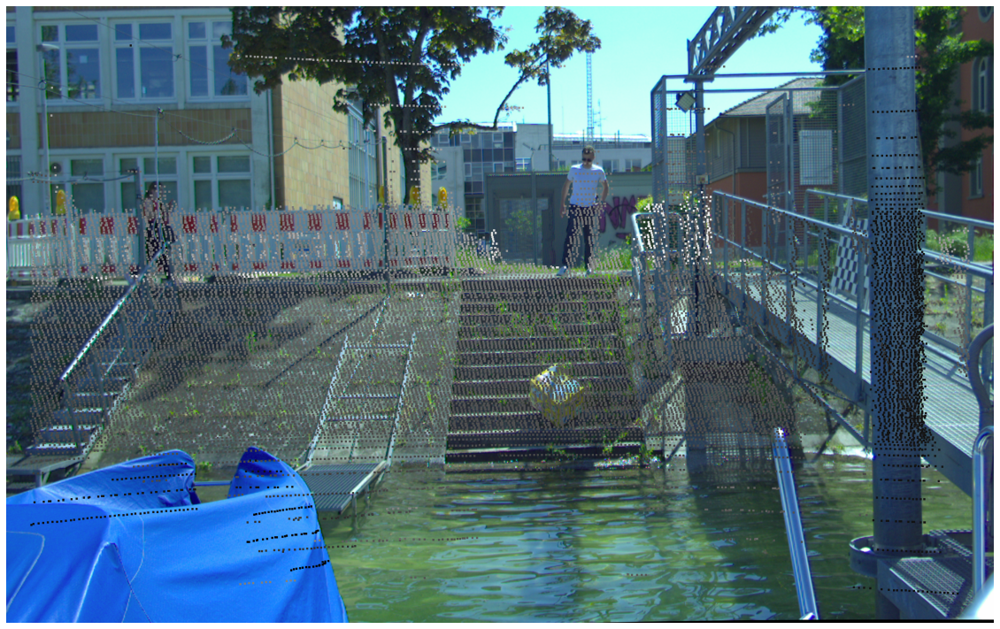

In [103]:
plt.rcParams["figure.figsize"] = (20,20)
plt.imshow(frames[-1])
plt.axis("off")

In [153]:
from Movie import *
images_to_video(frames, video_name = 'multisense_stereo_calib.avi')

error: OpenCV(3.4.2) /tmp/build/80754af9/opencv-suite_1535558553474/work/modules/highgui/src/window.cpp:626: error: (-2:Unspecified error) The function is not implemented. Rebuild the library with Windows, GTK+ 2.x or Carbon support. If you are on Ubuntu or Debian, install libgtk2.0-dev and pkg-config, then re-run cmake or configure script in function 'cvDestroyAllWindows'


# Test calibration and show MI loss surface

In [404]:
ac = AutoCalibration(kitti1.calib.T_cam2_velo, kitti1.calib.P_rect_20, 
                     pc_batch=5000, mi_batch=20, 
                     patch_size=96, hidden_size=32,  
                     true_kittis=datas, max_z_true_kittis=30
                     )

ac.to("cuda")
ac.load_state_dict(torch.load("checkpoints/mi_model_p128_small.pth.tar"))
ac.reset_calibration()

interval_t = np.random.uniform(0, 0.25, (3,))
interval_r = np.random.uniform(0, 10, (3,))
print("\n", "Distortion", "t: ", interval_t, "r: ",  interval_r, "\n")
ac.distort_calibration(interval_t, interval_r)

for iters, lr in [(4000, 1e-3), (1000, 1e-4), (1000, 1e-5), (1000, 1e-6)]:

    #ac.load_state_dict(torch.load("checkpoints/checkpoint_best_mi.pth.tar"))
    ac.update_se_and_mine(lr_mi=lr, lr_R=lr, lr_T=10*lr)
    ac.best_mi = 0.
    r = ac.fit(datas_test, iters=iters, log_interval=30, viz="none", 
               log_avg_window=1,
               n_test_batches=10, 
               valid_ratio=0.2, 
               grad_SE=True, 
               grad_R=True,
               grad_T=True)

r

#   0: nll: 0.55/0.45, mi:  0.526/ 1.204, acc: 77.5/80.5, eps: 0.01243, R=[-0.0, 3.99, -0.19], t=0.87, Q_cos=3.99
#  30: nll: 0.43/0.39, mi:  1.305/ 1.340, acc: 82.5/85.3, eps: 0.02586, R=[-0.06, 4.16, -0.03], t=0.84, Q_cos=4.16
Saved checkpoint
#  60: nll: 0.77/0.53, mi: -0.256/ 0.651, acc: 60.0/73.8, eps: 0.02726, R=[0.12, 4.52, -0.23], t=0.81, Q_cos=4.52
#  90: nll: 0.60/0.52, mi:  0.154/ 0.729, acc: 70.0/75.7, eps: 0.09281, R=[-0.16, 4.01, -0.17], t=0.91, Q_cos=4.01
# 120: nll: 0.41/0.47, mi:  1.092/ 0.931, acc: 85.0/76.5, eps: 0.00201, R=[-0.15, 4.05, -0.34], t=0.91, Q_cos=4.07
# 150: nll: 0.57/0.70, mi:  0.579/ 0.137, acc: 75.0/62.5, eps: 0.00093, R=[-0.05, 4.23, -0.09], t=0.91, Q_cos=4.22
# 180: nll: 0.56/0.53, mi:  0.733/ 0.761, acc: 67.5/72.5, eps: 0.00874, R=[-0.07, 4.22, -0.18], t=0.90, Q_cos=4.22
# 210: nll: 0.45/0.67, mi:  1.173/ 0.263, acc: 85.0/66.2, eps: 0.04382, R=[0.09, 4.59, -0.05], t=0.85, Q_cos=4.59
# 240: nll: 0.83/0.54, mi: -0.673/ 0.661, acc: 45.0/73.2, eps: 0.0

(      iter      loss        mi    acc        l2      t_l2      Q_cos    Rx  \
 0      0.0  1.008358 -0.310483  0.675  0.385145  0.293259  10.128415 -0.00   
 1     30.0  1.007309 -1.197517  0.400  0.428648  0.346896  10.214934 -0.49   
 2     60.0  0.733235  0.006373  0.575  0.410475  0.322601  10.296634 -0.44   
 3     90.0  0.786616 -0.367539  0.525  0.367162  0.266887  10.229165 -0.28   
 4    120.0  0.776300 -0.320171  0.625  0.349315  0.248633   9.953139 -0.28   
 ..     ...       ...       ...    ...       ...       ...        ...   ...   
 397  990.0  0.531118  0.452170  0.600  0.482180  0.480322   1.709317 -0.04   
 398    0.0  0.813729 -0.189562  0.600  0.482065  0.480206   1.709316 -0.04   
 399   30.0  0.595218  0.334751  0.550  0.482146  0.480289   1.708824 -0.04   
 400   60.0  0.458734  1.099099  0.825  0.482178  0.480321   1.708746 -0.04   
 401   90.0  0.500910  1.121869  0.600  0.482181  0.480324   1.708562 -0.04   
 
        Ry    Rz  
 0    9.17  4.31  
 1    9.21  

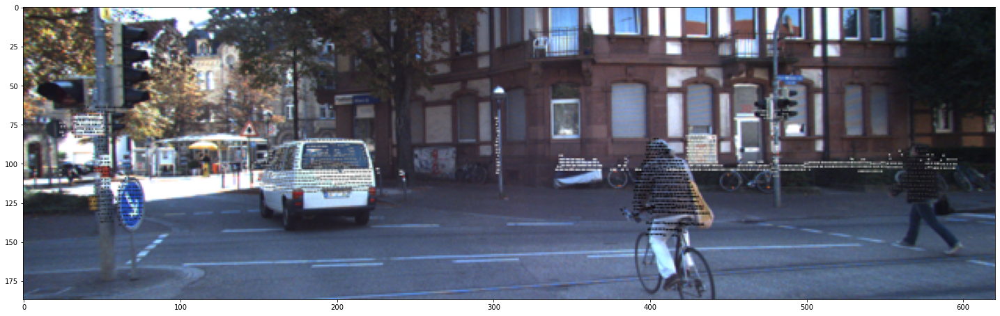

In [57]:
from itertools import product

idx = 0 # 
point_cloud, cam2, image3, oxts = datas[0][idx]

image, x, y, z, mask, max_x, max_y, max_z, valid_proj_pointcloud = ac.transform_points(point_cloud, cam2, clipping=True)

cam2_ = np.asarray(cam2).copy()

x, y, z = x.int().cpu().detach().numpy(), y.cpu().int().detach().numpy(), z.cpu().detach().numpy()
z = ( z- z.min())/( z.max()-  z.min()) * 255

from itertools import product
thick = 1
for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
    cam2_[y+y_, x+x_]     = np.array([z, z, z]).T


fig, ax = plt.subplots(figsize=(25, 25))


img = Image.fromarray(cam2_).resize((cam2_.shape[1]//2, cam2_.shape[0]//2))

ax.imshow(img)

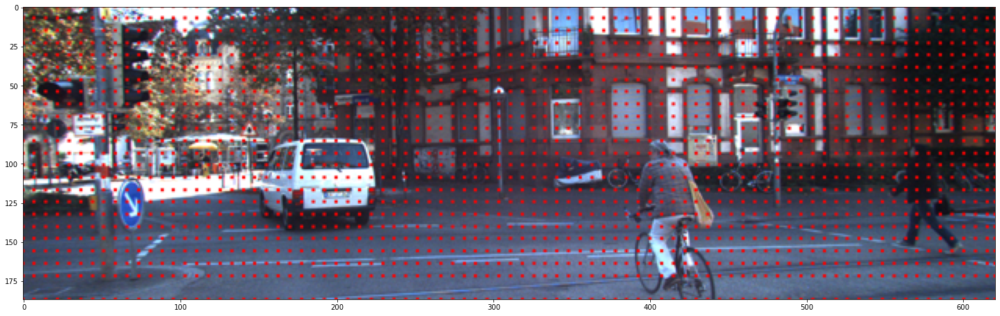

In [58]:
batch = 500
height = cam2_.shape[0] - 10 - 20
width  = cam2_.shape[1] - 10 
t = np.sqrt(height * width / batch)/2

# Subsample uniform grid for subsampling the point cloud
x = np.linspace(0, width, int(width//t) ) 
y = np.linspace(0, height, int(height//t) )
grid_2d = np.transpose([np.tile(x, len(y)), np.repeat(y, len(x))])

x, y = grid_2d.T.astype(np.int32)

cam2_ = np.asarray(cam2).copy()

from itertools import product
thick = 2
for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
    cam2_[y+y_, x+x_] = np.array([254, 0, 0]).T

fig, ax = plt.subplots(figsize=(25, 25))
img = Image.fromarray(cam2_).resize((cam2_.shape[1]//2, cam2_.shape[0]//2))
ax.imshow(img)

In [175]:
ac = AutoCalibration(kitti1.calib.T_cam2_velo, kitti1.calib.P_rect_20, 
                     pc_batch=5000, M=50, patch_size=96, hidden_size=32)

ac.to("cuda")
ac.load_state_dict(torch.load("checkpoints/mi_model_p96_small.pth.tar"))
ac.reset_calibration()


RT = torch.from_numpy(kitti1.calib.T_cam2_velo).float().to(ac.initRT.device)
P = torch.from_numpy(kitti1.calib.P_rect_20).float().to(ac.P_rect.device)

In [176]:
s = 15
J = 20
MI = np.zeros((J, 2, s))
iters = 1

for j in range(J):

    xx = np.linspace(-4, 4, s)

    for i,x in enumerate(xx):

        ac.reset_calibration()
        t = np.array([0,0,0])
        r = np.array([0,0,x])
        ac.distort_calibration(t, r)

        loss, mi_lb, acc, pred = ac.step(datas_test[0][1], 0, 1, grad_se=False, viz="none", 
                                         RT=None, P=None, grad_T=False, grad_R=False)

        MI[j, 0, i] = loss.detach().cpu().numpy()
        MI[j, 1, i] = mi_lb.detach().cpu().numpy()
        
        
    for iters, lr in [(1, 1e-3)]:
        ac.load_state_dict(torch.load("checkpoints/mi_model_p96_small.pth.tar"))
        ac.reset_calibration()
            
        ac.update_se_and_mine(lr_mi=lr, lr_R=lr, lr_T=10*lr)
        r = ac.fit(datas_test[j % len(datas_test)], iters=iters, log_interval=30, viz="none", 
                   log_avg_window=1,
                   n_test_batches=10, 
                   valid_ratio=0.2, 
                   grad_SE=True, 
                   grad_R=True,
                   grad_T=True)

#   0: nll: 0.47/0.38, mi:  0.816/ 1.566, acc: 81.0/83.2, eps: 0.01749, R=[-0.06, -0.06, 0.06], t=0.02, Q_cos=0.10
#   0: nll: 0.68/0.72, mi:  0.301/-0.093, acc: 62.0/60.3, eps: 0.00000, R=[-0.06, -0.06, 0.06], t=0.02, Q_cos=0.10
Fitting has converged 5.722104665095706e-10 < 1e-08
#   0: nll: 0.70/0.67, mi:  0.318/ 0.256, acc: 64.0/62.8, eps: 0.00000, R=[0.06, 0.06, 0.06], t=0.02, Q_cos=0.10
Fitting has converged 3.8885275555067267e-10 < 1e-08
#   0: nll: 0.67/0.58, mi:  0.161/ 0.692, acc: 63.0/67.7, eps: 0.00000, R=[-0.06, -0.06, 0.06], t=0.02, Q_cos=0.10
Fitting has converged 5.189527245430536e-10 < 1e-08
#   0: nll: 0.45/0.40, mi:  1.161/ 1.485, acc: 74.0/80.9, eps: 0.00000, R=[-0.06, 0.06, -0.06], t=0.02, Q_cos=0.10
Fitting has converged 3.8253759881978766e-10 < 1e-08
#   0: nll: 0.76/0.68, mi: -0.239/ 0.120, acc: 52.0/62.1, eps: 0.00000, R=[-0.06, -0.06, 0.06], t=0.02, Q_cos=0.10
Fitting has converged 0.0 < 1e-08
#   0: nll: 0.64/0.62, mi:  0.388/ 0.426, acc: 65.0/63.0, eps: 0.000

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:22: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


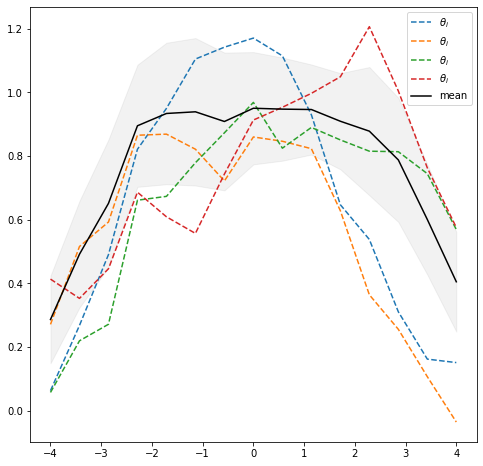

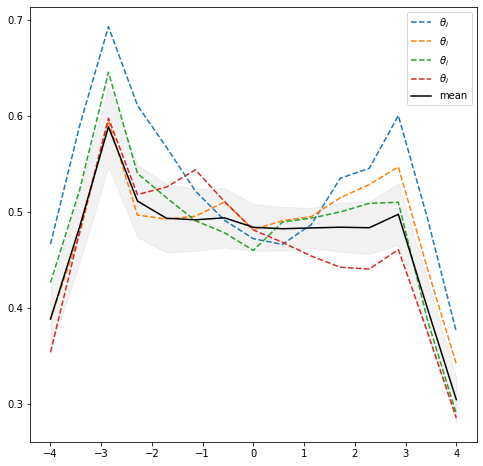

In [174]:
import tikzplotlib 


plt.rcParams["figure.figsize"] = (8,8)

j = 1
fig, ax = plt.subplots()

res = np.asarray([np.convolve(MI[i, j], np.ones(N)/N, mode='same') for i in range(len(MI))])

ci = res.std(0)
m = res.mean(0)

N = 5
for i in range(0,20, 5):
    y = res[i]
    ax.plot(xx,  y, "--", label=f"$\\theta_i$")

ax.plot(xx,  m, "black", label="mean")    
ax.fill_between(xx, (m-ci), (m+ci), color='gray', alpha=.1)
ax.legend()
fig.show()

tikzplotlib.save("MI_per_z.tex")

j = 0
fig, ax = plt.subplots()

res = np.asarray([np.convolve(MI[i, j], np.ones(N)/N, mode='same') for i in range(len(MI))])

ci = res.std(0)
m = res.mean(0)

N = 5
for i in range(0,20, 5):
    y = res[i]
    ax.plot(xx,  y, "--", label=f"$\\theta_i$")

ax.plot(xx,  m, "black", label="mean")    
ax.fill_between(xx, (m-ci), (m+ci), color='gray', alpha=.1)
ax.legend()
fig.show()

tikzplotlib.save("Loss_per_z.tex")


In [165]:
ac = AutoCalibration(kitti1.calib.T_cam2_velo, kitti1.calib.P_rect_20, 
                     pc_batch=5000, M=20, patch_size=96, hidden_size=32)

ac.to("cuda")
ac.load_state_dict(torch.load("checkpoints/mi_model_p96_small.pth.tar"))
ac.reset_calibration()


RT = torch.from_numpy(kitti1.calib.T_cam2_velo).float().to(ac.initRT.device)
P = torch.from_numpy(kitti1.calib.P_rect_20).float().to(ac.P_rect.device)

t = np.array([0,0,0])
r = np.array([1.,1.,1.])
ac.distort_calibration(t, r)

lr = 1e-3
ac.update_se_and_mine(lr_mi=lr, lr_R=lr, lr_T=lr)

In [166]:
s = 15
J = 100
MI = np.zeros((J, 2, s))
iters = 1

for j in range(J):
    
    if j % 5 == 0:

        xx = np.linspace(-4, 4, s)

        for i,x in enumerate(xx):

            R, T = ac.R.weight.data.clone(), ac.T.bias.data.clone()

            ac.reset_calibration()
            t = np.array([0,0,0])
            r = np.array([0,0,x])
            ac.distort_calibration(t, r)

            loss, mi_lb, acc, pred = ac.step(datas_test[0][1], 0, 1, grad_se=False, viz="none", 
                                             RT=None, P=None, grad_T=False, grad_R=False)

            MI[j // 5, 0, i] = loss.detach().cpu().numpy()
            MI[j // 5, 1, i] = mi_lb.detach().cpu().numpy()

            ac.R.weight.data, ac.T.bias.data = R, T

        
    r = ac.fit(datas_test[j % len(datas_test)], iters=iters, log_interval=30, viz="none", 
               log_avg_window=1,
               n_test_batches=10, 
               valid_ratio=0.2, 
               grad_SE=True, 
               grad_R=True,
               grad_T=True)

#   0: nll: 0.68/0.74, mi:  0.349/-0.060, acc: 72.5/55.8, eps: 0.04355, R=[0.94, 1.06, 1.06], t=0.00, Q_cos=1.76
#   0: nll: 0.81/0.90, mi:  0.124/-0.505, acc: 55.0/51.0, eps: 0.00148, R=[0.89, 1.04, 1.01], t=0.00, Q_cos=1.70
#   0: nll: 0.63/0.83, mi:  0.420/-0.176, acc: 65.0/53.7, eps: 0.00167, R=[0.84, 1.02, 0.97], t=0.00, Q_cos=1.63
#   0: nll: 0.66/0.82, mi:  0.304/-0.243, acc: 70.0/56.5, eps: 0.00104, R=[0.79, 0.98, 0.97], t=0.00, Q_cos=1.59
#   0: nll: 1.03/0.69, mi: -1.078/ 0.143, acc: 42.5/58.8, eps: 0.00112, R=[0.76, 0.95, 0.94], t=0.01, Q_cos=1.54
#   0: nll: 0.89/0.84, mi: -0.372/-0.238, acc: 57.5/53.2, eps: 0.00017, R=[0.76, 0.97, 0.93], t=0.00, Q_cos=1.54
#   0: nll: 0.78/0.83, mi: -0.134/-0.231, acc: 57.5/56.7, eps: 0.00006, R=[0.77, 0.98, 0.92], t=0.00, Q_cos=1.55
#   0: nll: 0.71/0.78, mi:  0.042/-0.326, acc: 65.0/59.5, eps: 0.00032, R=[0.77, 1.0, 0.92], t=0.00, Q_cos=1.56
#   0: nll: 0.91/0.69, mi: -0.558/ 0.126, acc: 57.5/59.8, eps: 0.00016, R=[0.77, 1.0, 0.91], t=0.

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:23: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/ipykernel_launcher.py:44: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


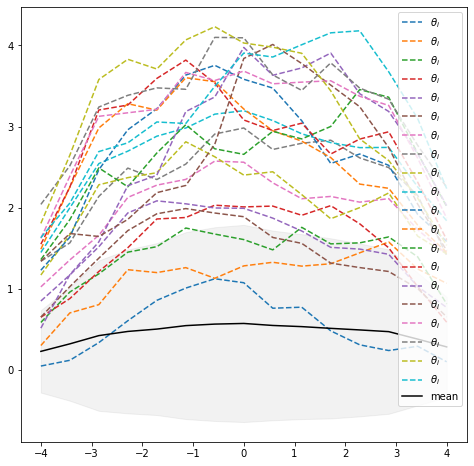

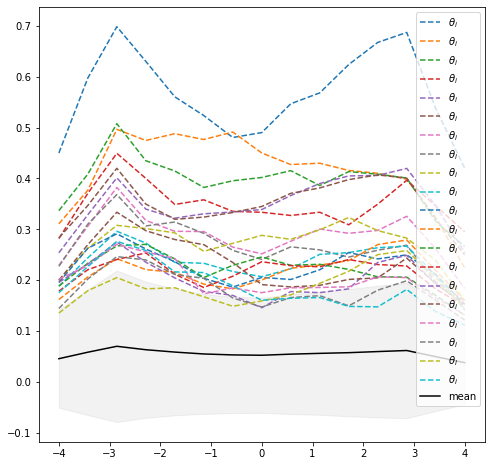

In [169]:
import tikzplotlib 


plt.rcParams["figure.figsize"] = (8,8)

j = 1
fig, ax = plt.subplots()

res = np.asarray([np.convolve(MI[i, j], np.ones(N)/N, mode='same') for i in range(len(MI))])

ci = res.std(0)
m = res.mean(0)

N = 5
for i in range(0,20):
    y = res[i]
    ax.plot(xx,  y, "--", label=f"$\\theta_i$")

ax.plot(xx,  m, "black", label="mean")    
ax.fill_between(xx, (m-ci), (m+ci), color='gray', alpha=.1)
#ax.set_title("MI")
ax.legend()
fig.show()

tikzplotlib.save("MI_per_z_iter.tex")

j = 0
fig, ax = plt.subplots()

res = np.asarray([np.convolve(MI[i, j], np.ones(N)/N, mode='same') for i in range(len(MI))])

ci = res.std(0)
m = res.mean(0)

N = 5
for i in range(0,20):
    y = res[i]
    ax.plot(xx,  y, "--", label=f"$\\theta_i$")

ax.plot(xx,  m, "black", label="mean")    
ax.fill_between(xx, (m-ci), (m+ci), color='gray', alpha=.1)
#ax.set_title("Loss")
ax.legend()
fig.show()

tikzplotlib.save("Loss_per_z_iter.tex")


In [ ]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate


for j in range(J):

    fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

    # Make data.
    X, Y = np.meshgrid(xx, yy)
    Z =  -MI[j, 0]

    xnew, ynew = np.mgrid[-5:5:100j, -5:5:100j]
    tck = interpolate.bisplrep(X, Y, Z, s=1)
    znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

    xnew = X
    ynew = Y
    znew = Z

    # Plot the surface.
    surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                           linewidth=0, antialiased=True)

    # Customize the z axis.
    ax.set_zlim(-1.0, 0.1)
    ax.zaxis.set_major_locator(LinearLocator(10))

    # A StrMethodFormatter is used automatically
    ax.zaxis.set_major_formatter('{x:.02f}')

    # Add a color bar which maps values to colors.
    fig.colorbar(surf, shrink=0.5, aspect=5)

    plt.rcParams["figure.figsize"] = (20, 20)
    plt.show()

In [14]:
s = 15
J = 3
MI = np.zeros((J, 2, s, s))

for j in range(J):

    xx = np.linspace(-5, 5, s)
    yy = np.linspace(-5, 5, s)

    for i,(x, y) in enumerate(product(xx, yy)):

        ac.reset_calibration()
        t = np.array([0,0,0])
        r = np.array([x,y,0])
        ac.distort_calibration(t, r)

        loss, mi_lb, acc, pred = ac.step(datas_test[0][1], 0, 1, grad_se=False, viz="none", 
                                         RT=None, P=None, grad_T=False, grad_R=False)

        MI[j, 0, i // s, i % s] = loss.detach().cpu().numpy()
        MI[j, 1, i // s, i % s] = mi_lb.detach().cpu().numpy()
        
        
    for iters, lr in [(1, 1e-3)]:

        ac.update_se_and_mine(lr_mi=lr, lr_R=lr, lr_T=10*lr)
        r = ac.fit(datas_test[0], iters=iters, log_interval=30, viz="none", 
                   log_avg_window=1,
                   n_test_batches=10, 
                   valid_ratio=0.2, 
                   grad_SE=True, 
                   grad_R=True,
                   grad_T=True)

#   0: nll: 1.04/0.63, mi: -0.669/ 0.298, acc: 55.0/61.3, eps: 0.17323, R=[4.94, 4.94, 0.05], t=0.02, Q_cos=6.99
#   0: nll: 1.82/0.62, mi: -2.688/ 0.372, acc: 57.5/67.5, eps: 0.00397, R=[5.06, 5.06, 0.06], t=0.02, Q_cos=7.15
Saved checkpoint
#   0: nll: 1.36/0.65, mi: -1.715/ 0.295, acc: 47.5/66.2, eps: 0.00189, R=[5.06, 4.94, -0.05], t=0.02, Q_cos=7.07


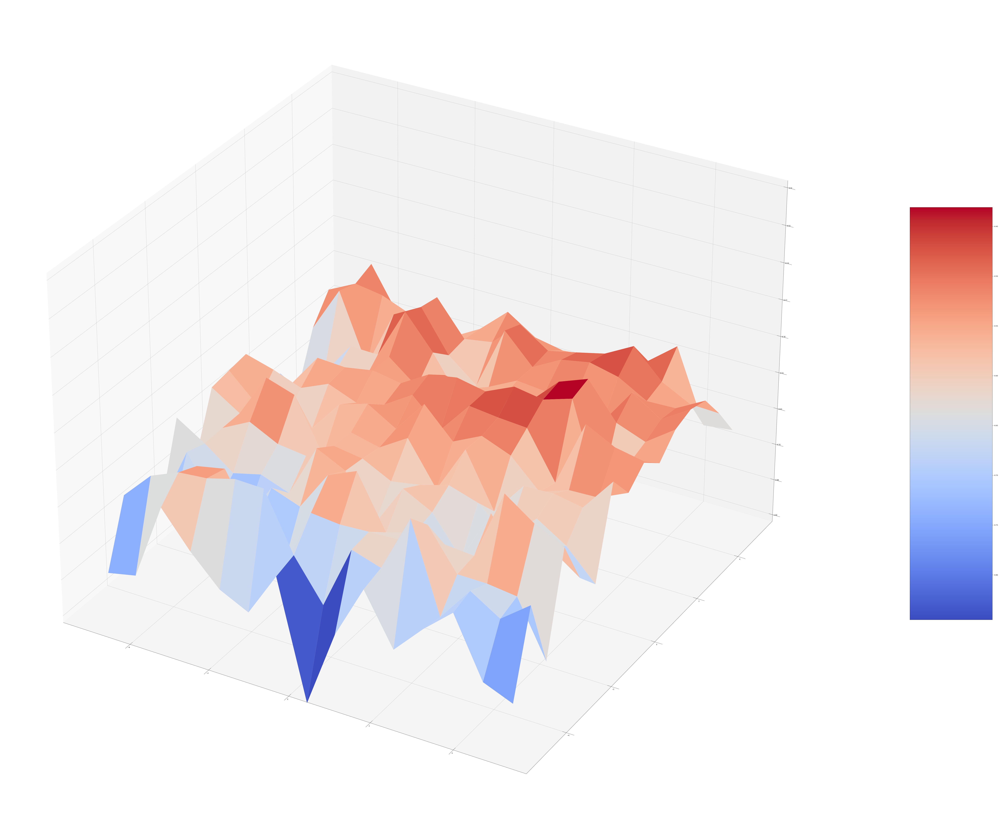

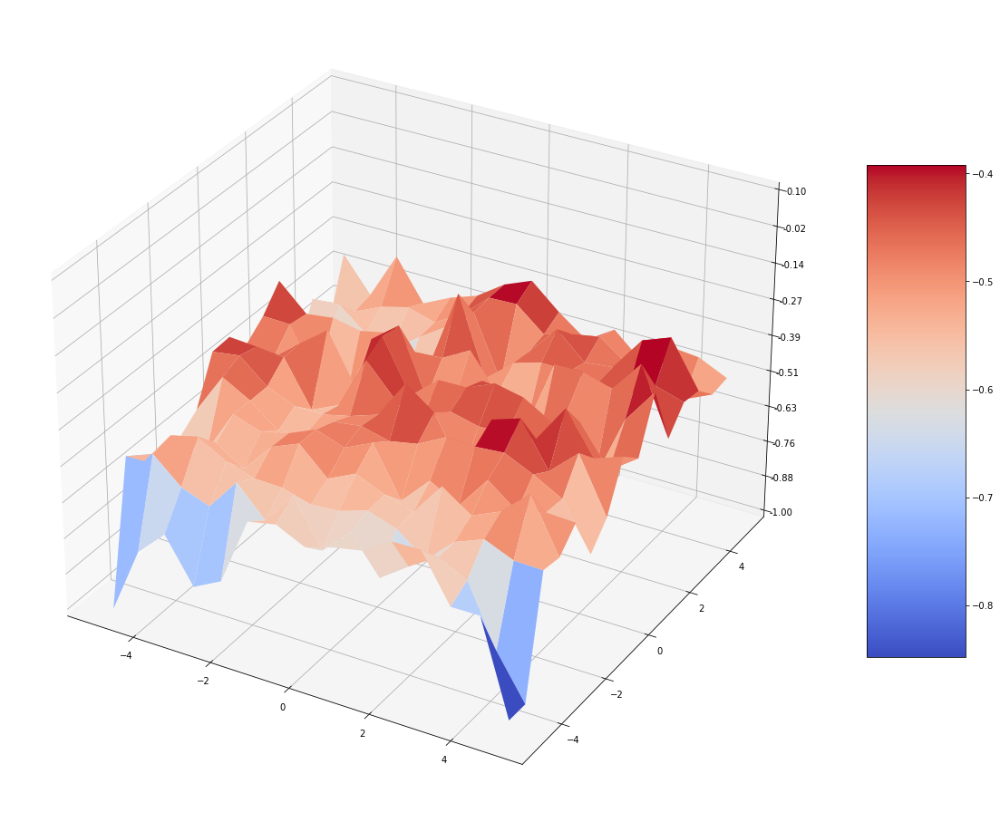

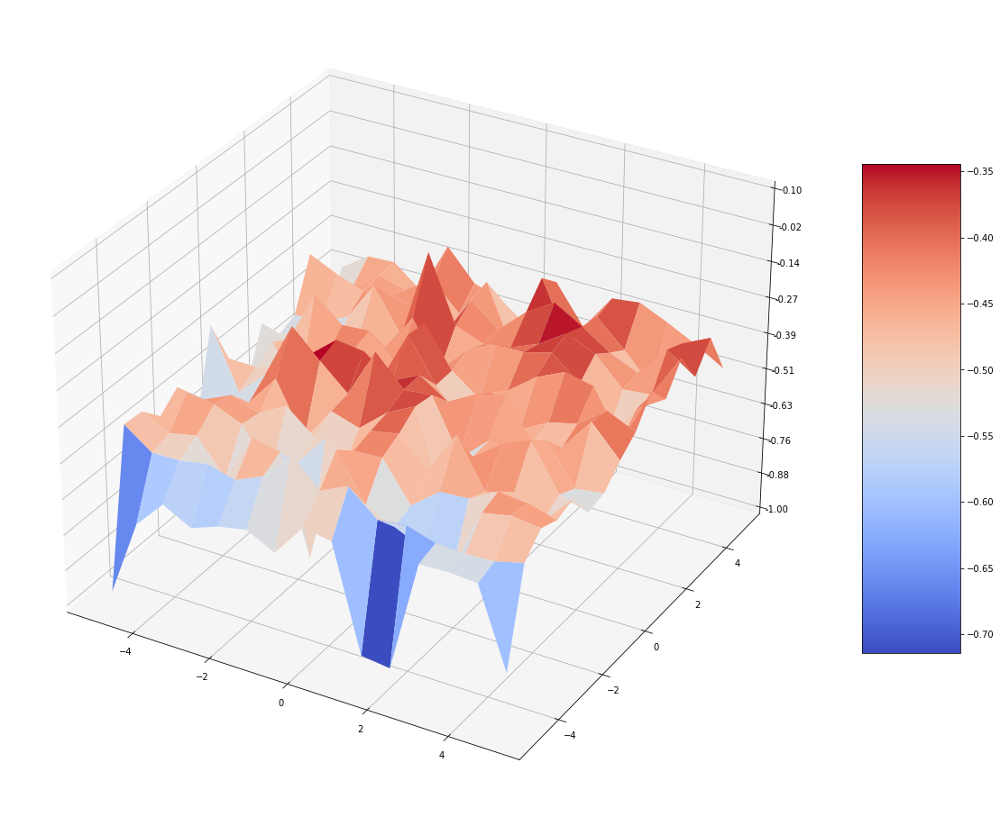

In [15]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate


for j in range(J):

    fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

    # Make data.
    X, Y = np.meshgrid(xx, yy)
    Z =  -MI[j, 0]

    xnew, ynew = np.mgrid[-5:5:100j, -5:5:100j]
    tck = interpolate.bisplrep(X, Y, Z, s=1)
    znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

    xnew = X
    ynew = Y
    znew = Z

    # Plot the surface.
    surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                           linewidth=0, antialiased=True)

    # Customize the z axis.
    ax.set_zlim(-1.0, 0.1)
    ax.zaxis.set_major_locator(LinearLocator(10))

    # A StrMethodFormatter is used automatically
    ax.zaxis.set_major_formatter('{x:.02f}')

    # Add a color bar which maps values to colors.
    fig.colorbar(surf, shrink=0.5, aspect=5)

    plt.rcParams["figure.figsize"] = (20, 20)
    plt.show()

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/scipy/interpolate/_fitpack_impl.py:977: RuntimeWarning: The required storage space exceeds the available storage space.
Probable causes: nxest or nyest too small or s is too small. (fp>s)
	kx,ky=3,3 nx,ny=13,13 m=225 fp=23.608054 s=2.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


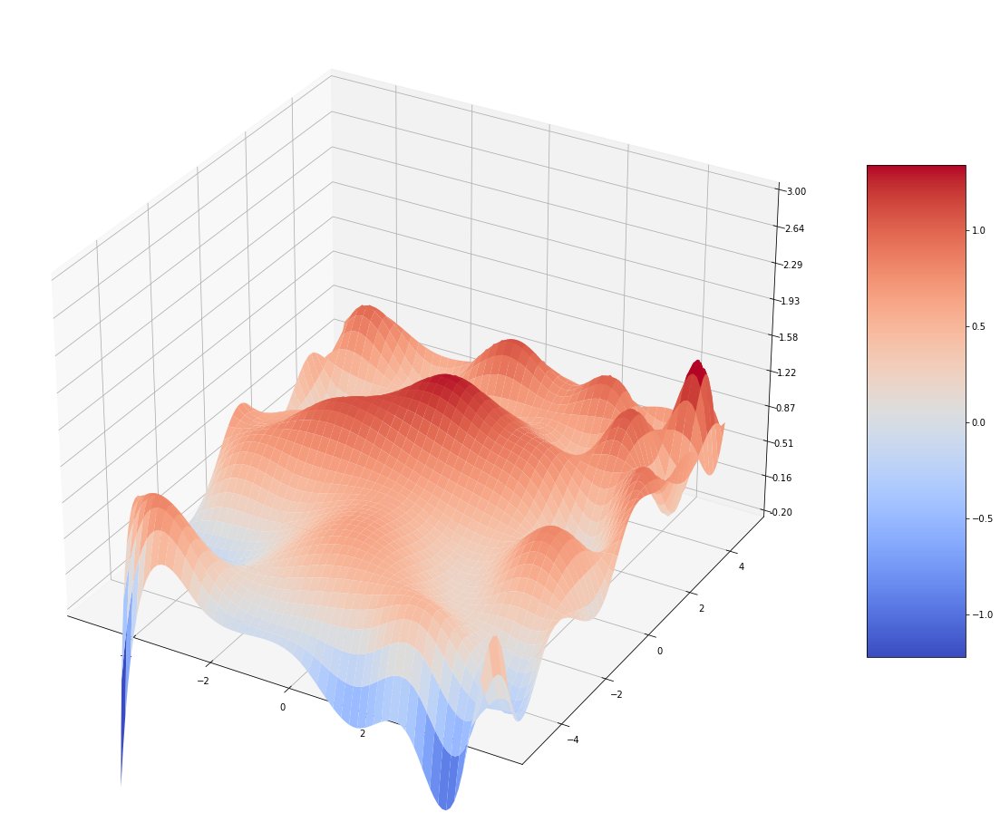

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/scipy/interpolate/_fitpack_impl.py:977: RuntimeWarning: The required storage space exceeds the available storage space.
Probable causes: nxest or nyest too small or s is too small. (fp>s)
	kx,ky=3,3 nx,ny=13,13 m=225 fp=28.796681 s=2.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


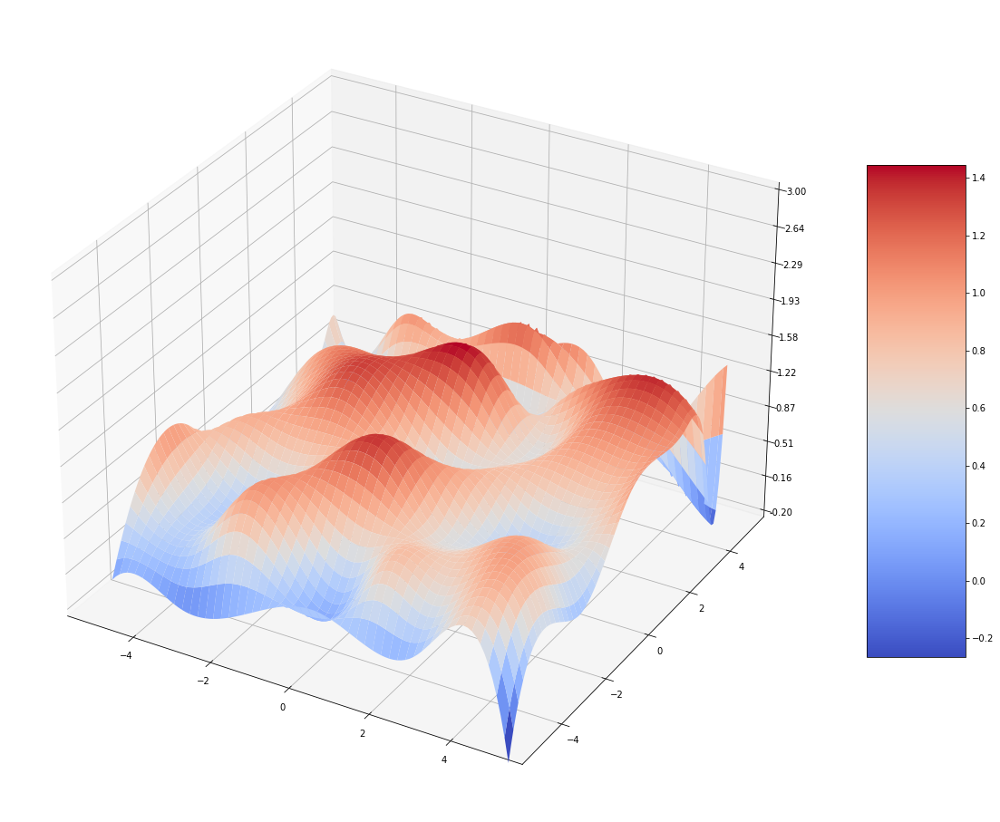

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/scipy/interpolate/_fitpack_impl.py:977: RuntimeWarning: The required storage space exceeds the available storage space.
Probable causes: nxest or nyest too small or s is too small. (fp>s)
	kx,ky=3,3 nx,ny=13,13 m=225 fp=28.135765 s=2.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


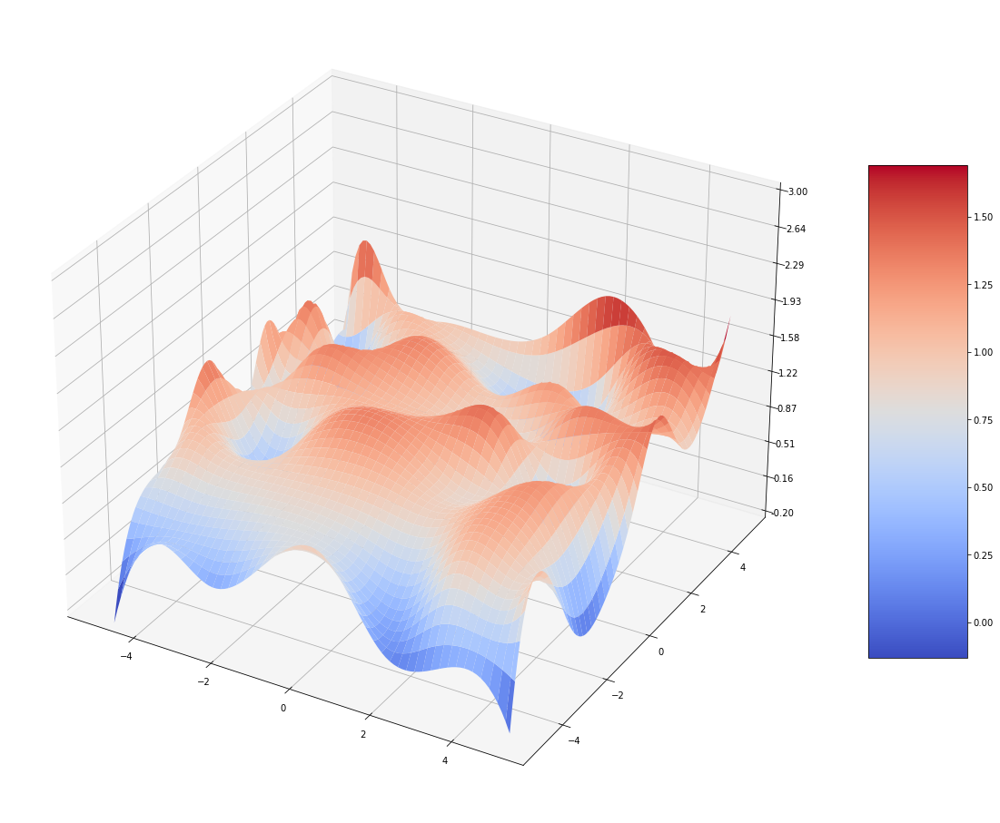

In [101]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate


for j in range(J):

    fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

    # Make data.
    X, Y = np.meshgrid(xx, yy)
    Z =  MI[j, 1]

    xnew, ynew = np.mgrid[-5:5:100j, -5:5:100j]
    tck = interpolate.bisplrep(X, Y, Z, s=2)
    znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

    #xnew = X
    #ynew = Y
    #znew = Z

    # Plot the surface.
    surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                           linewidth=0, antialiased=True)

    # Customize the z axis.
    ax.set_zlim(-0.2, 3.0)
    ax.zaxis.set_major_locator(LinearLocator(10))

    # A StrMethodFormatter is used automatically
    ax.zaxis.set_major_formatter('{x:.02f}')

    # Add a color bar which maps values to colors.
    fig.colorbar(surf, shrink=0.5, aspect=5)

    plt.rcParams["figure.figsize"] = (20, 20)
    plt.show()

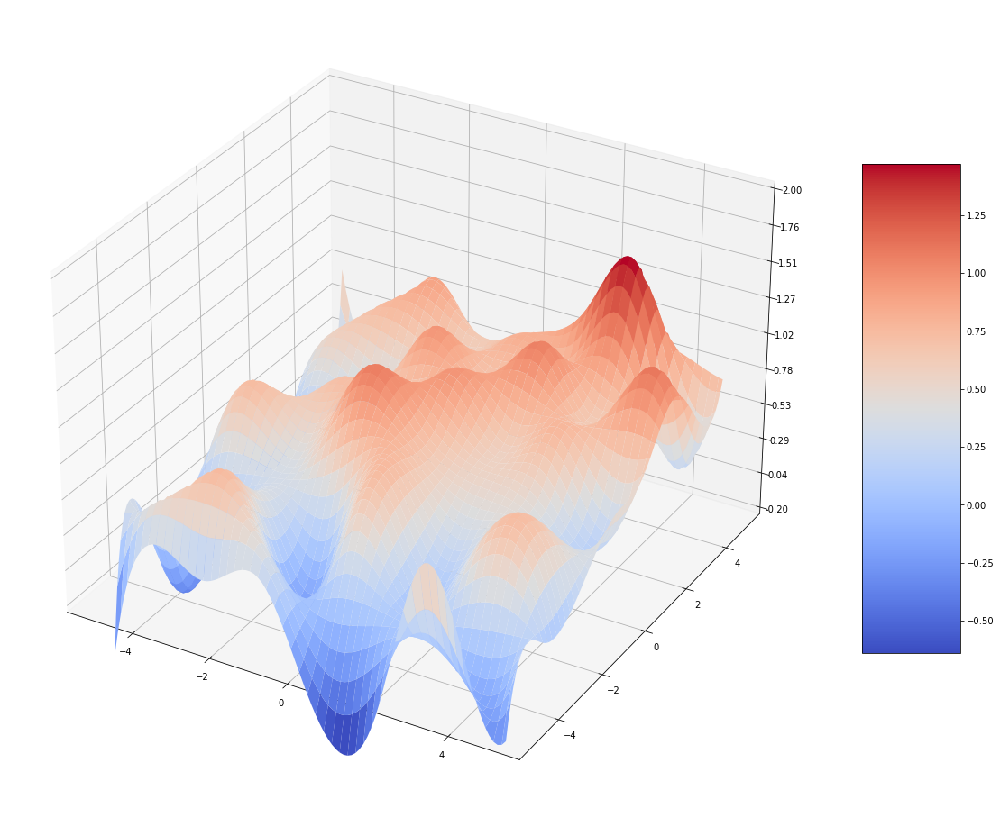

In [82]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

# Make data.
X, Y = np.meshgrid(xx, yy)
Z =  MI[1]

xnew, ynew = np.mgrid[-5:5:100j, -5:5:100j]
tck = interpolate.bisplrep(X, Y, Z, s=1)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

#xnew = X
#ynew = Y
#znew = Z

# Plot the surface.
surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
ax.set_zlim(-0.2, 2.0)
ax.zaxis.set_major_locator(LinearLocator(10))

# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.rcParams["figure.figsize"] = (20, 20)
plt.show()

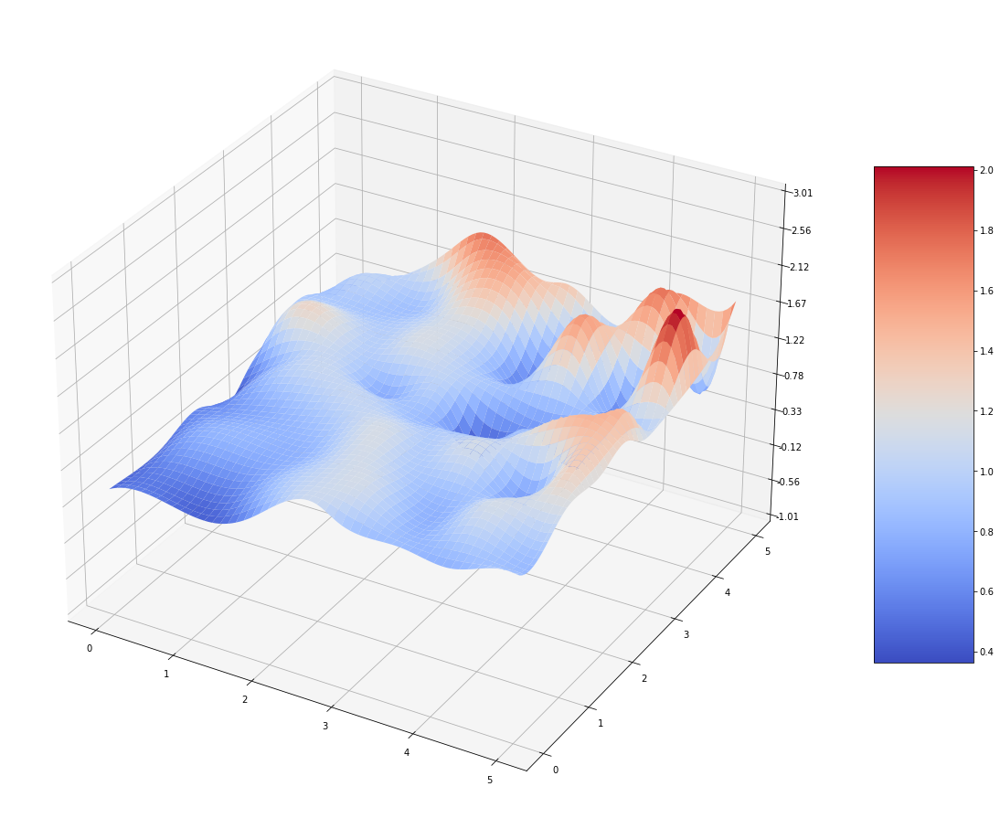

In [23]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

# Make data.
X, Y = np.meshgrid(xx, yy)
Z =  MI[0]

xnew, ynew = np.mgrid[0:5:100j, 0:5:100j]
tck = interpolate.bisplrep(X, Y, Z, s=0)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

#xnew = X
#ynew = Y
#znew = Z

# Plot the surface.
surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
ax.set_zlim(-1.01, 3.01)
ax.zaxis.set_major_locator(LinearLocator(10))

# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.rcParams["figure.figsize"] = (20, 20)
plt.show()

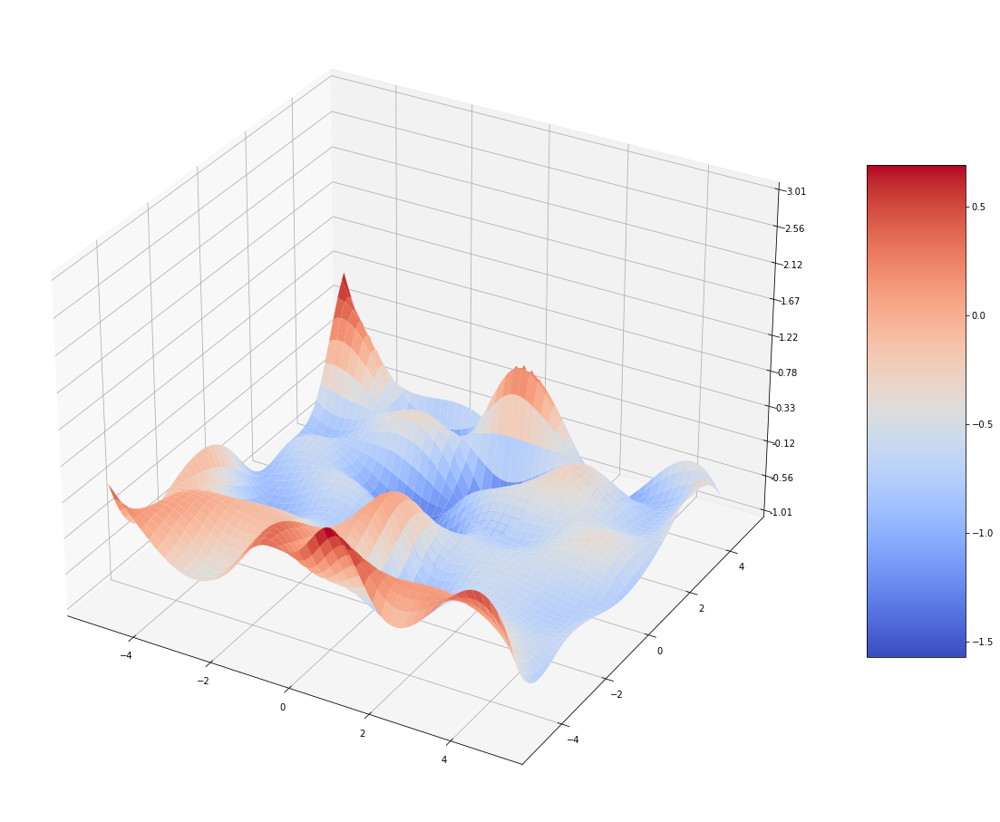

In [22]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

# Make data.
X, Y = np.meshgrid(xx, yy)
Z = -MI[1]
#Z =  MI[0]

xnew, ynew = np.mgrid[-5:5:100j, -5:5:100j]
tck = interpolate.bisplrep(X, Y, Z, s=1)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

#xnew = X
#ynew = Y
#znew = Z

# Plot the surface.
surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
ax.set_zlim(-1.01, 3.01)
ax.zaxis.set_major_locator(LinearLocator(10))

# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.rcParams["figure.figsize"] = (20, 20)
plt.show()

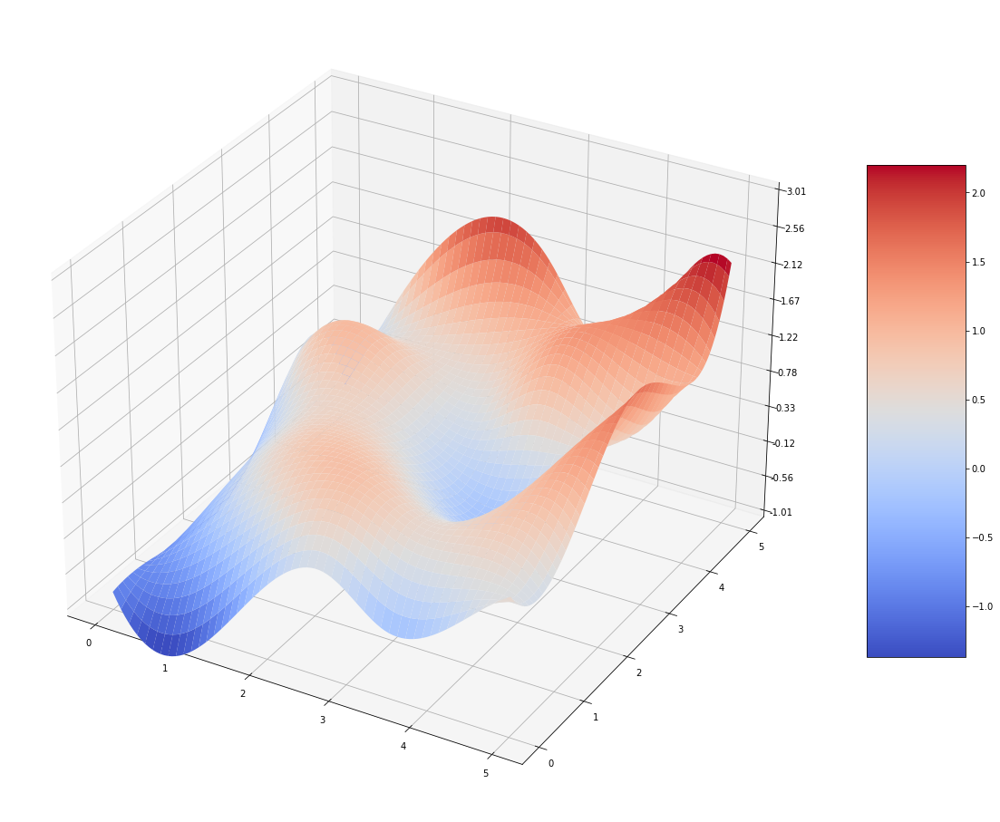

In [34]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

# Make data.
X, Y = np.meshgrid(xx, yy)
Z = -MI[1]
#Z =  MI[0]

xnew, ynew = np.mgrid[0:5:100j, 0:5:100j]
tck = interpolate.bisplrep(X, Y, Z, s=1)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

#xnew = X
#ynew = Y
#znew = Z

# Plot the surface.
surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
ax.set_zlim(-1.01, 3.01)
ax.zaxis.set_major_locator(LinearLocator(10))

# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.rcParams["figure.figsize"] = (20, 20)
plt.show()

In [48]:
for iters, lr in [(1, 1e-3)]:

    #ac.load_state_dict(torch.load("checkpoints/checkpoint_best_mi.pth.tar"))
    ac.update_se_and_mine(lr_mi=lr, lr_R=lr, lr_T=10*lr)
    r = ac.fit(datas_test, iters=iters, log_interval=30, viz="none", 
               log_avg_window=1,
               n_test_batches=10, 
               valid_ratio=0.2, 
               grad_SE=True, 
               grad_R=True,
               grad_T=True)

#   0: nll: 1.09/0.98, mi: -1.282/-0.749, acc: 55.0/53.3, eps: 0.00000, R=[4.94, 5.06, -0.06], t=0.02, Q_cos=7.07
Fitting has converged 4.275141379794789e-09 < 1e-05


In [49]:
s = 10
MI = np.zeros((2, s, s))

xx = np.linspace(0, 5, s)
yy = np.linspace(0, 5, s)

for i,(x, y) in enumerate(product(xx, yy)):
                          
    ac.reset_calibration()
    t = np.array([0,0,0])
    r = np.array([x,y,0])
    ac.distort_calibration(t, r)
    # print("\n", "Distortion", "t: ", t, "r: ",  r, "\n")


    loss, mi_lb, acc, pred = ac.step(datas_test[0], 0, 1, grad_se=False, viz="none", 
                                     RT=None, P=None, grad_T=False, grad_R=False)
    
    #print(loss, mi_lb)
    
    MI[0, i // s, i % s] = loss.detach().cpu().numpy()
    MI[1, i // s, i % s] = mi_lb.detach().cpu().numpy()

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/scipy/interpolate/_fitpack_impl.py:977: RuntimeWarning: The required storage space exceeds the available storage space.
Probable causes: nxest or nyest too small or s is too small. (fp>s)
	kx,ky=3,3 nx,ny=10,10 m=100 fp=19.105747 s=1.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


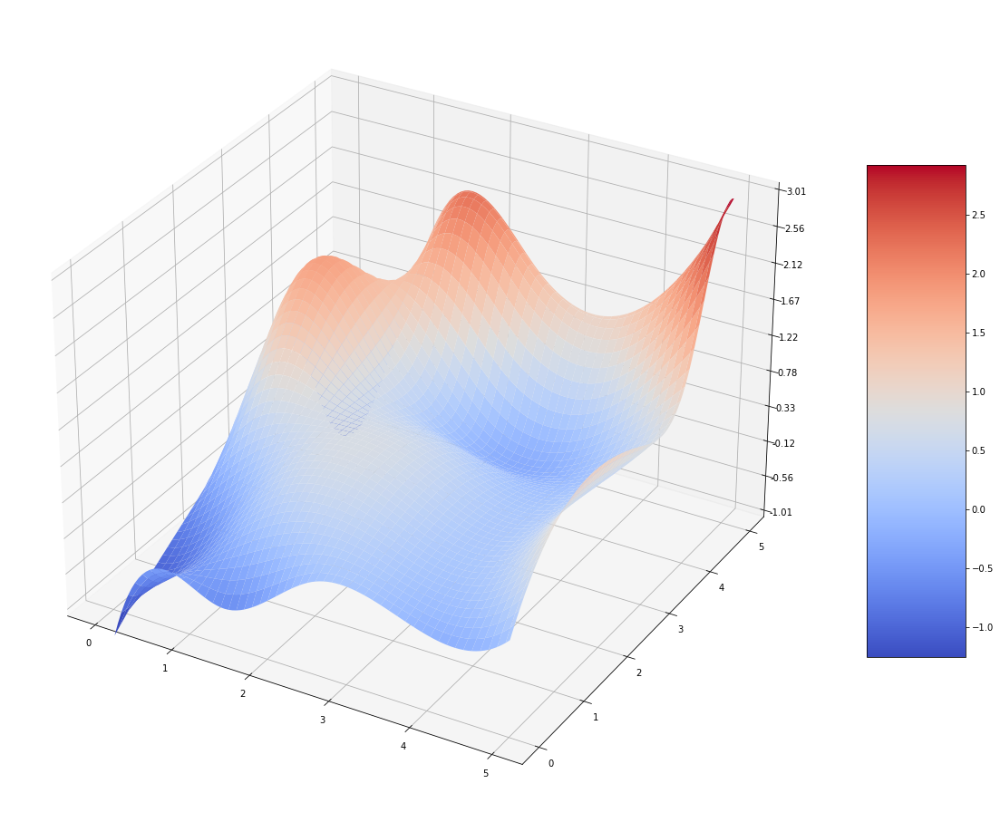

In [47]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

# Make data.
X, Y = np.meshgrid(xx, yy)
Z = -MI[1]
#Z =  MI[0]

xnew, ynew = np.mgrid[0:5:100j, 0:5:100j]
tck = interpolate.bisplrep(X, Y, Z, s=1)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

#xnew = X
#ynew = Y
#znew = Z

# Plot the surface.
surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
ax.set_zlim(-1.01, 3.01)
ax.zaxis.set_major_locator(LinearLocator(10))

# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.rcParams["figure.figsize"] = (20, 20)
plt.show()

/home/ios/anaconda3/envs/pytorch/lib/python3.7/site-packages/scipy/interpolate/_fitpack_impl.py:977: RuntimeWarning: The required storage space exceeds the available storage space.
Probable causes: nxest or nyest too small or s is too small. (fp>s)
	kx,ky=3,3 nx,ny=10,10 m=100 fp=19.493284 s=1.000000
  warnings.warn(RuntimeWarning(_iermess2[ierm][0] + _mess))


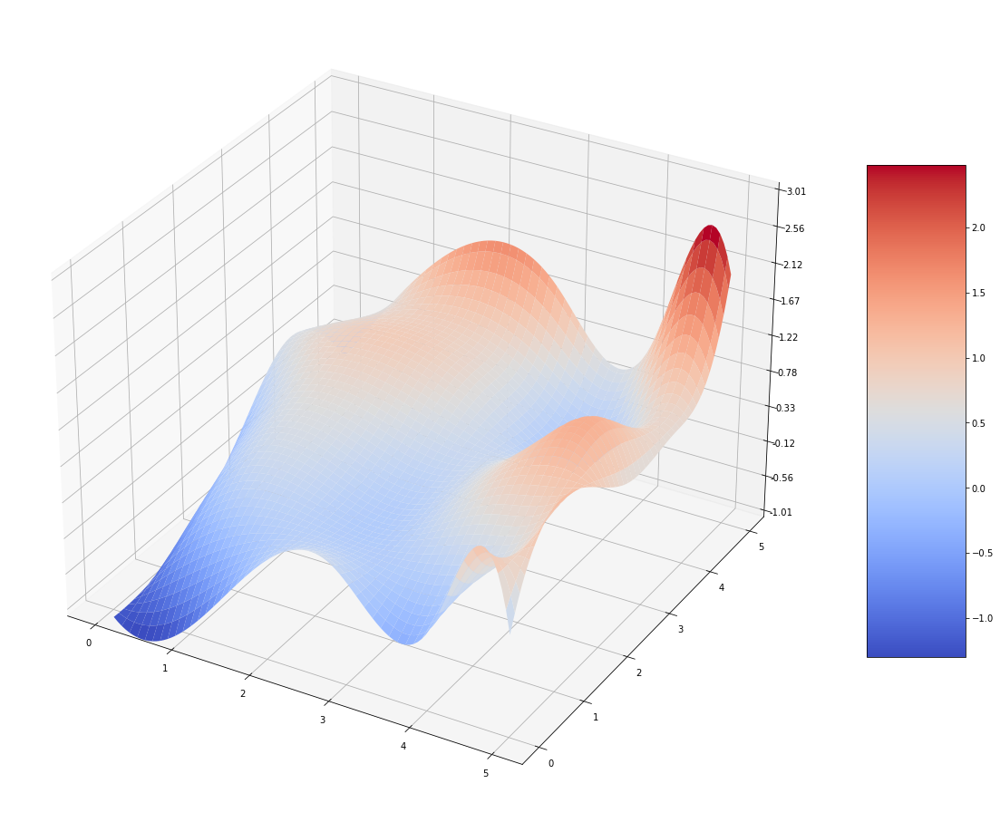

In [50]:
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np
from scipy import interpolate

fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

# Make data.
X, Y = np.meshgrid(xx, yy)
Z = -MI[1]
#Z =  MI[0]

xnew, ynew = np.mgrid[0:5:100j, 0:5:100j]
tck = interpolate.bisplrep(X, Y, Z, s=1)
znew = interpolate.bisplev(xnew[:,0], ynew[0,:], tck)

#xnew = X
#ynew = Y
#znew = Z

# Plot the surface.
surf = ax.plot_surface(xnew, ynew, znew, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=True)

# Customize the z axis.
ax.set_zlim(-1.01, 3.01)
ax.zaxis.set_major_locator(LinearLocator(10))

# A StrMethodFormatter is used automatically
ax.zaxis.set_major_formatter('{x:.02f}')

# Add a color bar which maps values to colors.
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.rcParams["figure.figsize"] = (20, 20)
plt.show()

# Visualization

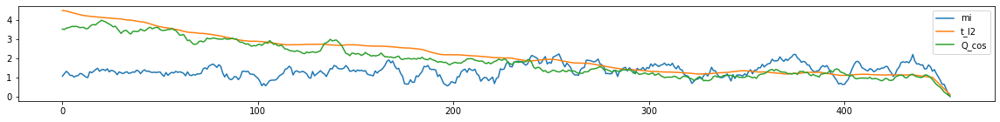

In [71]:
def runningMeanFast(x, N=10):
    return np.convolve(x, np.ones((N,))/N)[(N-1):]


#plt.plot(runningMeanFast(r[1]["loss"]) / r[1]["loss"].std(), label="loss")
plt.plot(runningMeanFast(r[1]["mi"])/ r[1]["mi"].std(), label="mi")
#plt.plot(runningMeanFast(r[1]["acc"])/ r[1]["acc"].std(), label="acc")
plt.plot(runningMeanFast(r[1]["t_l2"])/ r[1]["t_l2"].std(), label="t_l2")
plt.plot(runningMeanFast(r[1]["Q_cos"])/ r[1]["Q_cos"].std(), label="Q_cos")
plt.rcParams["figure.figsize"] = (20,2)
plt.legend()

In [27]:
ac.load_state_dict(torch.load("checkpoints/mi_model_p96_small_registered.pth.tar"))

<All keys matched successfully>

In [48]:
!mv checkpoints/checkpoint.pth.tar checkpoints/mi_model_p96_small_registered.pth.tar

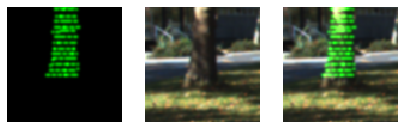

(tensor([4.0077]), tensor([-4.8475]))

In [71]:
np.random.seed(12)
pred_j, pred_m = ac.step(datas[2], 120, 150, viz="jointn", batch_size=1)[3].view(2, -1)
pred_j, pred_m

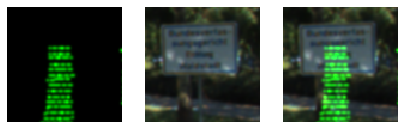

(tensor([2.4351]), tensor([-3.1762]))

In [72]:
np.random.seed(5)
pred_j, pred_m = ac.step(datas[2], 120, 150, viz="marginaln", batch_size=1)[3].view(2, -1)
pred_j, pred_m

In [16]:
ac = AutoCalibration(kitti1.calib.T_cam2_velo, kitti1.calib.P_rect_20, 
                     pc_batch=5000, M=20, 
                     patch_size=96, hidden_size=32
                     )

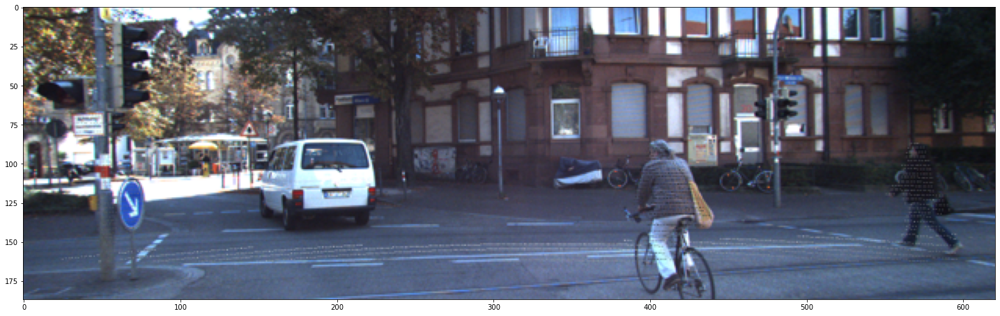

In [50]:
import imageio
from PIL import Image

idx = 0
point_cloud, cam2, image3, oxts, im_labels, velo_labels = datas[0][idx]

image, x, y, z, mask, max_x, max_y, max_z, valid_proj_pointcloud = ac.transform_points(point_cloud, cam2, clipping=False)

cam2_ = np.asarray(cam2).copy()

x, y, z = x.int().cpu().detach().numpy(), y.cpu().int().detach().numpy(), z.cpu().detach().numpy()
x = x[z < 10]
y = y[z < 10]
z = z[z < 10]
z = ( z- z.min())/( z.max()-  z.min()) * 255
cam2_[y, x] = np.array([z, z, z]).T

fig, ax = plt.subplots(figsize=(25, 25))


img = Image.fromarray(cam2_).resize((cam2_.shape[1]//2, cam2_.shape[0]//2))

ax.imshow(img)

(-0.5, 1241.5, 374.5, -0.5)

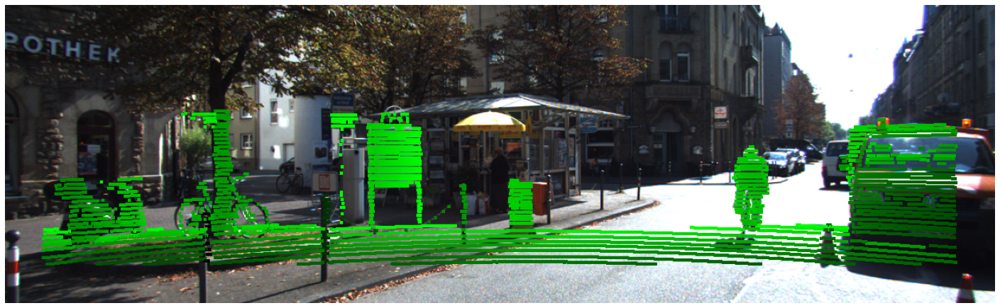

In [23]:
ac.reset_calibration()
idx = 90
point_cloud, cam2, image3, oxts = datas[0][idx]

image, x, y, z, I, mask, max_x, max_y, max_z, valid_proj_pointcloud = ac.transform_points(point_cloud, cam2, clipping=False)

cam2_ = np.asarray(cam2).copy()

x, y, z = x.int().cpu().detach().numpy(), y.cpu().int().detach().numpy(), z.cpu().detach().numpy()
x = x[z < 12]
y = y[z < 12]
z = z[z < 12]
z = ( z- z.min())/( z.max()-  z.min()) * 255

from itertools import product
thick = 2
for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
    cam2_[y+y_, x+x_]     = np.array([0*z, z, 0*z]).T

fig, ax = plt.subplots(figsize=(25, 25))

img = Image.fromarray(cam2_).resize((cam2_.shape[1]//2, cam2_.shape[0]//2))

ax.imshow(cam2_)
ax.axis("off")

In [24]:
ac = AutoCalibration(kitti1.calib.T_cam2_velo, kitti1.calib.P_rect_20, 
                     pc_batch=5000, M=20, 
                     patch_size=96, hidden_size=32, max_z=50
                     )
ac.distort_calibration([0.5,0.5,0.5], [2,2,2])

(-0.5, 1241.5, 374.5, -0.5)

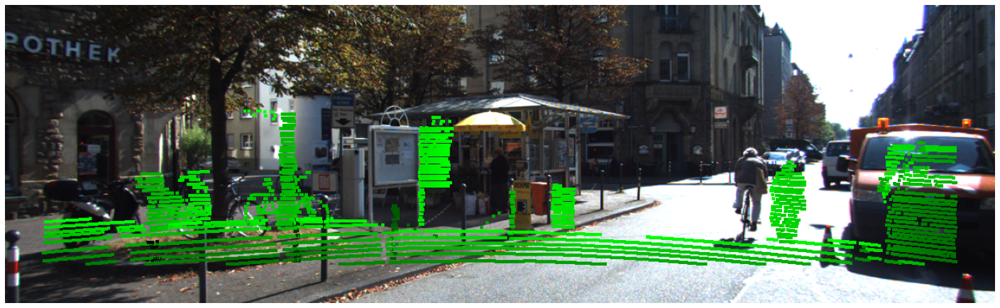

In [26]:
idx = 90
point_cloud, cam2, image3, oxts = datas[0][idx]

image, x, y, z, I, mask, max_x, max_y, max_z, valid_proj_pointcloud = ac.transform_points(point_cloud, cam2, clipping=False)

cam2_ = np.asarray(cam2).copy()

x, y, z = x.int().cpu().detach().numpy(), y.cpu().int().detach().numpy(), z.cpu().detach().numpy()
x = x[z < 12]
y = y[z < 12]
z = z[z < 12]
z = ( z- z.min())/( z.max()-  z.min()) * 255

from itertools import product
thick = 2
for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
    cam2_[y+y_, x+x_]     = np.array([0*z, z, 0*z]).T

fig, ax = plt.subplots(figsize=(25, 25))

#img = Image.fromarray(cam2_).resize((cam2_.shape[1]//2, cam2_.shape[0]//2))

ax.imshow(cam2_)
ax.axis("off")

In [18]:
ls "/home/ios/data3/multisense/"

1623860613_500.hdf5  1623860633_500.hdf5  1623860653_700.hdf5
1623860613_600.hdf5  1623860633_600.hdf5  1623860653_800.hdf5
1623860613_700.hdf5  1623860633_700.hdf5  1623860653_900.hdf5
1623860613_800.hdf5  1623860633_800.hdf5  1623860654_000.hdf5
1623860613_900.hdf5  1623860633_900.hdf5  1623860654_100.hdf5
1623860614_000.hdf5  1623860634_000.hdf5  1623860654_200.hdf5
1623860614_100.hdf5  1623860634_100.hdf5  1623860654_300.hdf5
1623860614_200.hdf5  1623860634_200.hdf5  1623860654_400.hdf5
1623860614_300.hdf5  1623860634_300.hdf5  1623860654_500.hdf5
1623860614_400.hdf5  1623860634_400.hdf5  1623860654_600.hdf5
1623860614_500.hdf5  1623860634_500.hdf5  1623860654_700.hdf5
1623860614_600.hdf5  1623860634_600.hdf5  1623860654_800.hdf5
1623860614_700.hdf5  1623860634_700.hdf5  1623860654_900.hdf5
1623860614_800.hdf5  1623860634_800.hdf5  1623860655_000.hdf5
1623860614_900.hdf5  1623860634_900.hdf5  1623860655_100.hdf5
1623860615_000.hdf5  1623860635_000.hdf5  1623860655_200.hdf5
16238606

# Maritime Grid

In [3]:
from datasets.MultiSenseDataset import *

In [4]:
BASE_DIR = "/home/ios/data3_/multisense/"

ds = MultiSenseData(BASE_DIR, rectified=True, crop=[0 ,0, -1, -1], preload=True)
velo, cam_left, cam_right, _ = ds[450]
datas = [ds]
ds

MultiSenseData(base_path=/home/ios/data3_/multisense/)[596]

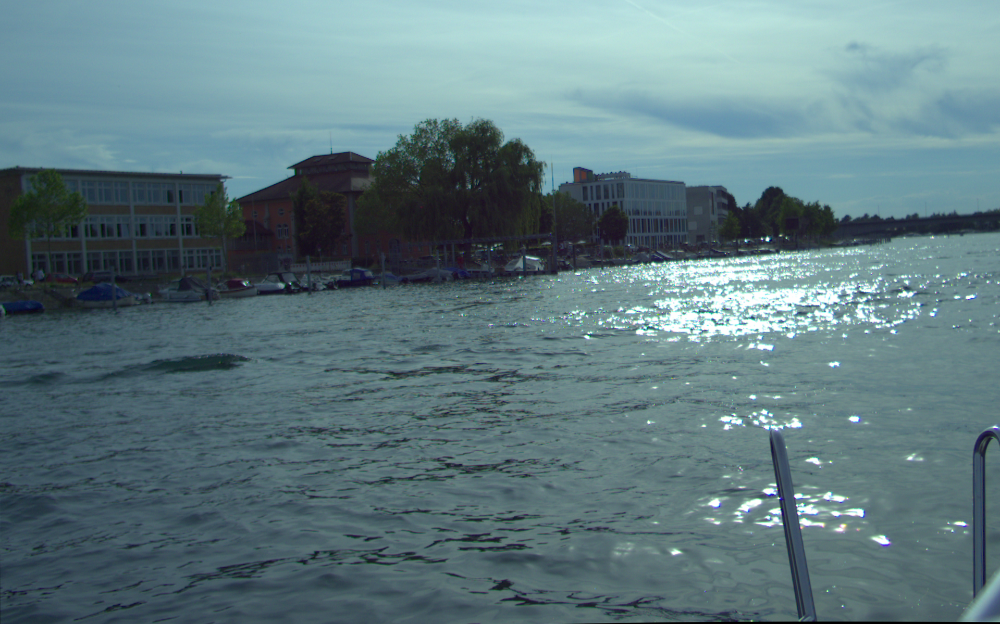

In [8]:
point_cloud, cam2, image3, oxts = datas[0][0]
cam2

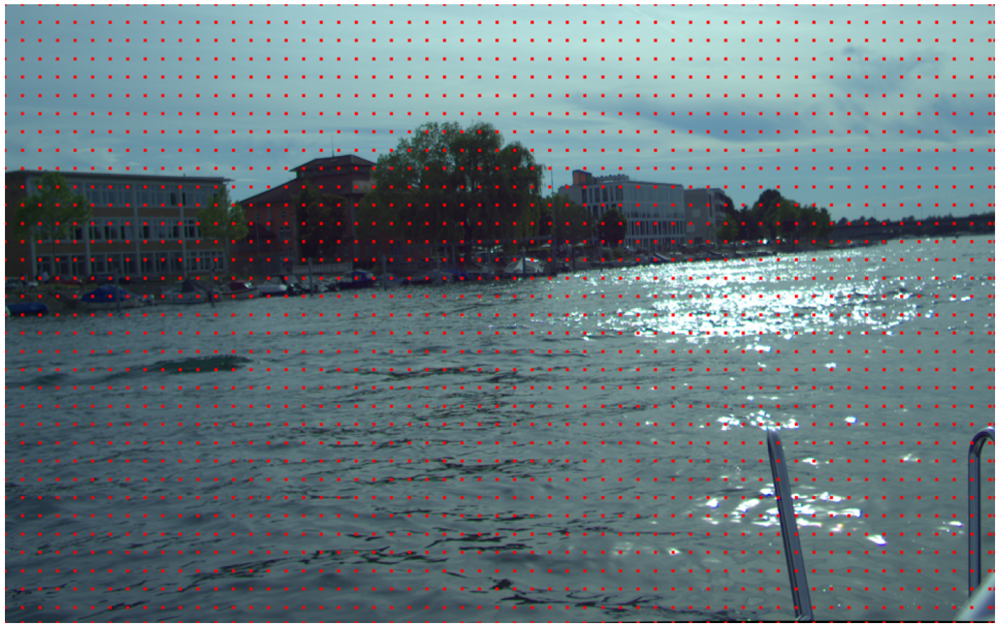

In [12]:
cam2_ = np.asarray(cam2).copy()

batch = 500
height = cam2_.shape[0] - 10 - 20
width  = cam2_.shape[1] - 10 
t = np.sqrt(height * width / batch)/2

# Subsample uniform grid for subsampling the point cloud
x = np.linspace(0, width, int(width//t) ) 
y = np.linspace(0, height, int(height//t) )
grid_2d = np.transpose([np.tile(x, len(y)), np.repeat(y, len(x))])

x, y = grid_2d.T.astype(np.int32)

cam2_ = np.asarray(cam2).copy()

from itertools import product
thick = 3
for i, (x_, y_) in enumerate(product(range(-thick, thick), range(-thick, thick))):
    cam2_[y+y_, x+x_] = np.array([254, 0, 0]).T

fig, ax = plt.subplots(figsize=(25, 25))
img = Image.fromarray(cam2_).resize((cam2_.shape[1]//2, cam2_.shape[0]//2))
ax.axis("off")
ax.imshow(img)